In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px

In [2]:
listing_df = pd.read_csv("listings.csv")
listing_df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,5121,Rental unit in Brooklyn · ★4.52 · 1 bedroom · ...,7356,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60,30,50,2019-12-02,0.29,2,0,0,NaN
1,2595,Rental unit in New York · ★4.68 · Studio · 1 b...,2845,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240,30,49,2022-06-21,0.30,3,325,1,NaN
2,14991,Rental unit in New York · ★4.93 · 1 bedroom · ...,59023,Bianca,Manhattan,Lower East Side,40.72207,-73.98976,Private room,120,5,22,2023-05-14,0.14,1,268,3,NaN
3,5136,Rental unit in Brooklyn · ★5.0 · 2 bedrooms · ...,7378,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,276,21,3,2022-08-10,0.03,1,275,1,NaN
4,59709,Rental unit in New York · ★4.77 · 2 bedrooms ·...,186084,Ricardo & Ashlie,Manhattan,Chinatown,40.71780,-73.99320,Entire home/apt,325,7,69,2023-04-28,0.47,1,38,23,NaN


In [3]:
listing_df.shape

(43566, 18)

In [4]:
neighbourhoods_df = pd.read_csv("neighbourhoods.csv")
neighbourhoods_df.head()

,neighbourhood_group,neighbourhood
0,Bronx,Allerton
1,Bronx,Baychester
2,Bronx,Belmont
3,Bronx,Bronxdale
4,Bronx,Castle Hill


In [5]:
neighbourhoods_df.shape


(230, 2)

In [6]:

df_combined = pd.concat([listing_df, neighbourhoods_df])# concat listing and neighbour in neighbourhood and neighbourhood_group
df_combined.head()


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,5121.0,Rental unit in Brooklyn · ★4.52 · 1 bedroom · ...,7356.0,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60.0,30.0,50.0,2019-12-02,0.29,2.0,0.0,0.0,NaN
1,2595.0,Rental unit in New York · ★4.68 · Studio · 1 b...,2845.0,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240.0,30.0,49.0,2022-06-21,0.30,3.0,325.0,1.0,NaN
2,14991.0,Rental unit in New York · ★4.93 · 1 bedroom · ...,59023.0,Bianca,Manhattan,Lower East Side,40.72207,-73.98976,Private room,120.0,5.0,22.0,2023-05-14,0.14,1.0,268.0,3.0,NaN
3,5136.0,Rental unit in Brooklyn · ★5.0 · 2 bedrooms · ...,7378.0,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,276.0,21.0,3.0,2022-08-10,0.03,1.0,275.0,1.0,NaN
4,59709.0,Rental unit in New York · ★4.77 · 2 bedrooms ·...,186084.0,Ricardo & Ashlie,Manhattan,Chinatown,40.71780,-73.99320,Entire home/apt,325.0,7.0,69.0,2023-04-28,0.47,1.0,38.0,23.0,NaN


In [7]:
df_combined.shape

(43796, 18)

In [8]:
reviw_df = pd.read_csv("reviews.csv")
reviw_df.head()

,listing_id,date
0,5121,2009-05-28
1,2595,2009-11-21
2,2595,2009-12-05
3,2595,2009-12-10
4,2595,2010-04-09


In [9]:
reviw_df['last_review'] = reviw_df['date']# change date column to be last review to concat the two files 

In [10]:
reviw_df.drop(['date'],axis = 1,inplace =True)
reviw_df.head()

,listing_id,last_review
0,5121,2009-05-28
1,2595,2009-11-21
2,2595,2009-12-05
3,2595,2009-12-10
4,2595,2010-04-09


In [11]:
reviw_df.shape

(1148772, 2)

In [12]:
df = pd.concat([df_combined, reviw_df])
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,listing_id
0,5121.0,Rental unit in Brooklyn · ★4.52 · 1 bedroom · ...,7356.0,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60.0,30.0,50.0,2019-12-02,0.29,2.0,0.0,0.0,NaN,NaN
1,2595.0,Rental unit in New York · ★4.68 · Studio · 1 b...,2845.0,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240.0,30.0,49.0,2022-06-21,0.30,3.0,325.0,1.0,NaN,NaN
2,14991.0,Rental unit in New York · ★4.93 · 1 bedroom · ...,59023.0,Bianca,Manhattan,Lower East Side,40.72207,-73.98976,Private room,120.0,5.0,22.0,2023-05-14,0.14,1.0,268.0,3.0,NaN,NaN
3,5136.0,Rental unit in Brooklyn · ★5.0 · 2 bedrooms · ...,7378.0,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,276.0,21.0,3.0,2022-08-10,0.03,1.0,275.0,1.0,NaN,NaN
4,59709.0,Rental unit in New York · ★4.77 · 2 bedrooms ·...,186084.0,Ricardo & Ashlie,Manhattan,Chinatown,40.71780,-73.99320,Entire home/apt,325.0,7.0,69.0,2023-04-28,0.47,1.0,38.0,23.0,NaN,NaN


In [13]:
# Clean Data:
df.isna().sum()/(df.shape[0]) * 100
    

id                                 96.346875
name                               96.346875
host_id                            96.346875
host_name                          96.347294
neighbourhood_group                96.327589
neighbourhood                      96.327589
latitude                           96.346875
longitude                          96.346875
room_type                          96.346875
price                              96.346875
minimum_nights                     96.346875
number_of_reviews                  96.346875
last_review                         0.899404
reviews_per_month                  97.226993
calculated_host_listings_count     96.346875
availability_365                   96.346875
number_of_reviews_ltm              96.346875
license                           100.000000
listing_id                          3.672411
dtype: float64

# we have that column last review and listing id have  less than 1 % and 3.6 % respectively so when we delete them the data will not be affected  so let's drop them

In [14]:
df.drop(['listing_id',"last_review","license"],axis = 1,inplace =True)

In [15]:
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,5121.0,Rental unit in Brooklyn · ★4.52 · 1 bedroom · ...,7356.0,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60.0,30.0,50.0,0.29,2.0,0.0,0.0
1,2595.0,Rental unit in New York · ★4.68 · Studio · 1 b...,2845.0,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240.0,30.0,49.0,0.30,3.0,325.0,1.0
2,14991.0,Rental unit in New York · ★4.93 · 1 bedroom · ...,59023.0,Bianca,Manhattan,Lower East Side,40.72207,-73.98976,Private room,120.0,5.0,22.0,0.14,1.0,268.0,3.0
3,5136.0,Rental unit in Brooklyn · ★5.0 · 2 bedrooms · ...,7378.0,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,276.0,21.0,3.0,0.03,1.0,275.0,1.0
4,59709.0,Rental unit in New York · ★4.77 · 2 bedrooms ·...,186084.0,Ricardo & Ashlie,Manhattan,Chinatown,40.71780,-73.99320,Entire home/apt,325.0,7.0,69.0,0.47,1.0,38.0,23.0


In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1192568 entries, 0 to 1148771
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              43566 non-null  float64
 1   name                            43566 non-null  object 
 2   host_id                         43566 non-null  float64
 3   host_name                       43561 non-null  object 
 4   neighbourhood_group             43796 non-null  object 
 5   neighbourhood                   43796 non-null  object 
 6   latitude                        43566 non-null  float64
 7   longitude                       43566 non-null  float64
 8   room_type                       43566 non-null  object 
 9   price                           43566 non-null  float64
 10  minimum_nights                  43566 non-null  float64
 11  number_of_reviews               43566 non-null  float64
 12  reviews_per_month           

In [17]:
df.fillna({'reviews_per_month':0}, inplace=True)
df.reviews_per_month.isnull().sum()

0

# we can remove anothe nan values  as they just 4% of our data


In [18]:
df =df.fillna(0)
df.head(4)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,5121.0,Rental unit in Brooklyn · ★4.52 · 1 bedroom · ...,7356.0,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60.0,30.0,50.0,0.29,2.0,0.0,0.0
1,2595.0,Rental unit in New York · ★4.68 · Studio · 1 b...,2845.0,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240.0,30.0,49.0,0.30,3.0,325.0,1.0
2,14991.0,Rental unit in New York · ★4.93 · 1 bedroom · ...,59023.0,Bianca,Manhattan,Lower East Side,40.72207,-73.98976,Private room,120.0,5.0,22.0,0.14,1.0,268.0,3.0
3,5136.0,Rental unit in Brooklyn · ★5.0 · 2 bedrooms · ...,7378.0,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,276.0,21.0,3.0,0.03,1.0,275.0,1.0


In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1192568 entries, 0 to 1148771
Data columns (total 16 columns):
 #   Column                          Non-Null Count    Dtype  
---  ------                          --------------    -----  
 0   id                              1192568 non-null  float64
 1   name                            1192568 non-null  object 
 2   host_id                         1192568 non-null  float64
 3   host_name                       1192568 non-null  object 
 4   neighbourhood_group             1192568 non-null  object 
 5   neighbourhood                   1192568 non-null  object 
 6   latitude                        1192568 non-null  float64
 7   longitude                       1192568 non-null  float64
 8   room_type                       1192568 non-null  object 
 9   price                           1192568 non-null  float64
 10  minimum_nights                  1192568 non-null  float64
 11  number_of_reviews               1192568 non-null  float64
 12  

In [20]:
df.shape

(1192568, 16)

In [21]:
df.neighbourhood_group.unique()

array(['Brooklyn', 'Manhattan', 'Bronx', 'Queens', 'Staten Island', 0],
      dtype=object)

In [22]:
df.host_name.unique()

array(['Garon', 'Jennifer', 'Bianca', ..., 'Einab', 'Quick Stay',
       'Sohaib'], dtype=object)

In [23]:
cat_columns = ['neighbourhood_group','neighbourhood','room_type','host_name']

for col in df[cat_columns]:
    if df[col].dtype == 'object':
        print(df[col].unique())
    else:
        print("Not object")

['Brooklyn' 'Manhattan' 'Bronx' 'Queens' 'Staten Island' 0]
['Bedford-Stuyvesant' 'Midtown' 'Lower East Side' 'Sunset Park'
 'Chinatown' 'Upper West Side' 'South Slope' 'Tribeca' 'Williamsburg'
 'Chelsea' 'East Village' 'Greenwich Village' 'Clinton Hill' 'East Harlem'
 'Harlem' 'Washington Heights' 'Upper East Side' 'Fort Greene'
 'Greenpoint' 'Clason Point' 'Kips Bay' 'Eastchester' 'Flatbush'
 "Hell's Kitchen" 'Crown Heights' 'Carroll Gardens' 'West Village'
 'Nolita' 'Park Slope' 'Long Island City' 'East Flatbush' 'Gowanus'
 'Forest Hills' 'Murray Hill' 'Prospect Heights' 'Astoria' 'Boerum Hill'
 'Sunnyside' 'Kingsbridge' 'St. George' 'Ridgewood' 'Mott Haven'
 'Morningside Heights' 'Bushwick' 'Ditmars Steinway' 'Middle Village'
 'Jamaica' 'Windsor Terrace' 'University Heights' 'Brooklyn Heights'
 'Flatiron District' 'Rockaway Beach' 'Allerton' 'Emerson Hill'
 'East New York' 'Theater District' 'Fort Hamilton' 'Bensonhurst'
 'Rego Park' 'Wakefield' 'Kensington' 'Stuyvesant Town' 'Wood

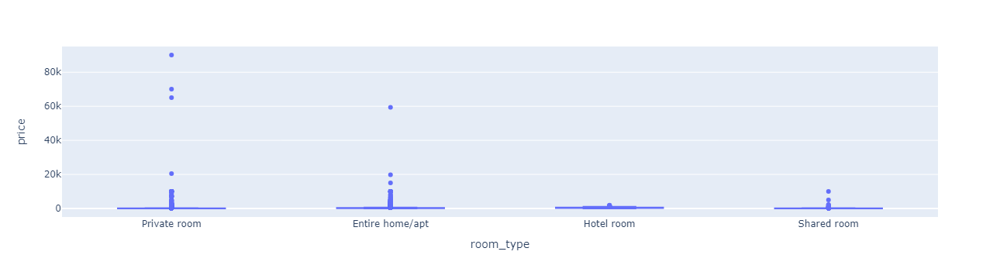

In [24]:
df = df[df['room_type'] != 0] 
fig = px.box(df, x='room_type', y='price')
fig.show()

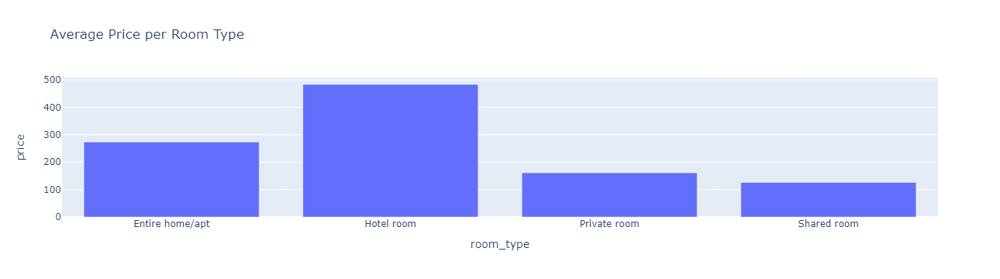

In [25]:
avg_prices = df.groupby('room_type')['price'].mean().reset_index()

fig = px.bar(avg_prices, x='room_type', y='price', 
             title='Average Price per Room Type')
fig.show()


In [26]:
hosts = df['host_name'].value_counts()
print(hosts.nlargest(10)) 

Blueground      569
RoomPicks       506
Eugene          494
June            422
Michael         353
David           309
Outpost Club    264
Hiroki          235
Shogo           219
Momoyo          207
Name: host_name, dtype: int64


In [27]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5)
kmeans.fit(df[['latitude', 'longitude']]) 

df['cluster'] = kmeans.predict(df[['latitude', 'longitude']])

C:\Users\ayama\.anaconda\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [28]:
df['cluster']

0        3
1        4
2        4
3        0
4        4
        ..
43561    3
43562    0
43563    4
43564    3
43565    4
Name: cluster, Length: 43566, dtype: int32

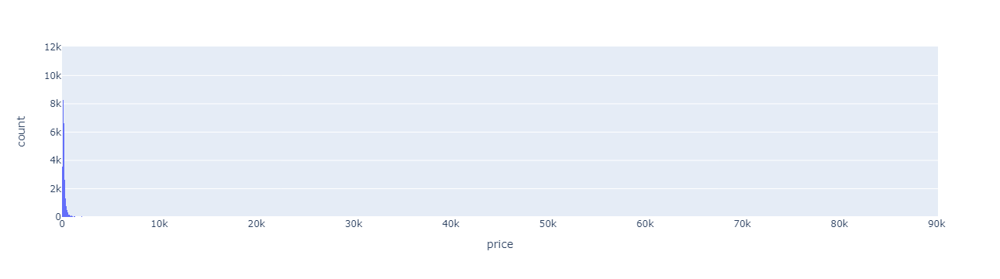

In [29]:
fig = px.histogram(df, x="price")

fig.show() 


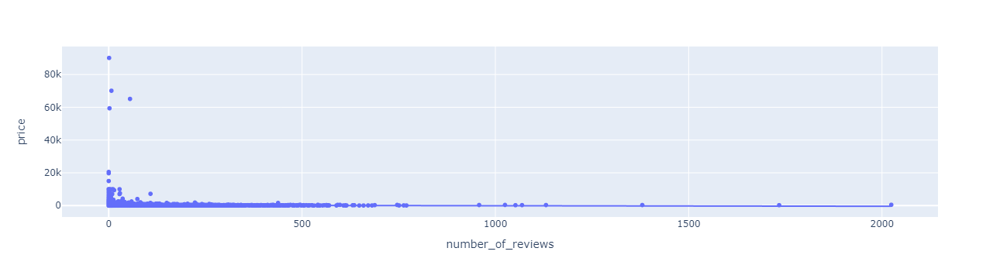

In [30]:
fig = px.scatter(df, x="number_of_reviews", y="price",trendline="ols")
fig.show() 


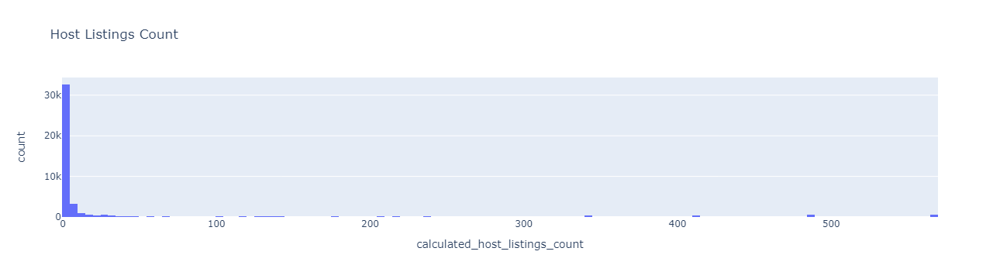

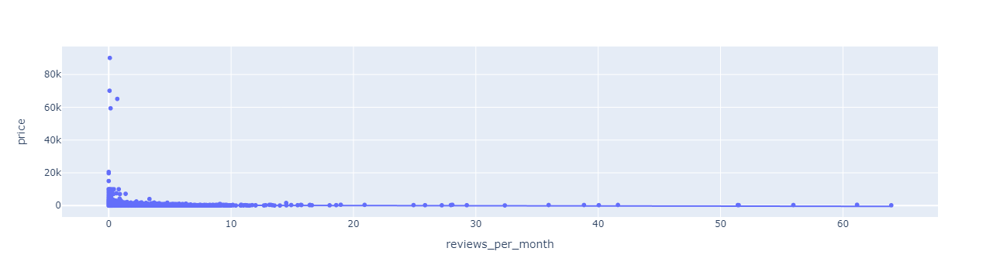

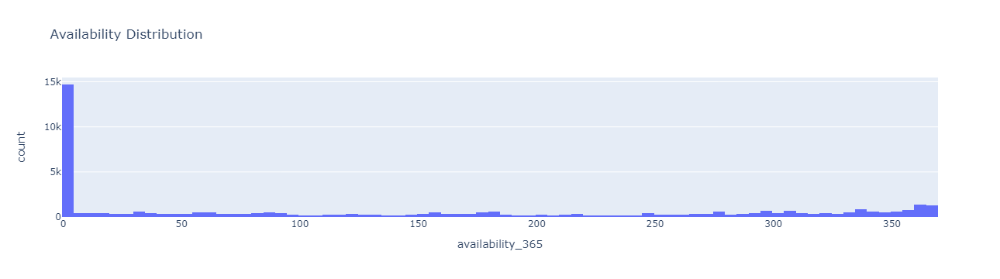

In [31]:

# Host listings count distribution
fig = px.histogram(df, x="calculated_host_listings_count", title='Host Listings Count')
fig.show()

# Reviews per month vs price 
fig = px.scatter(df, x="reviews_per_month", y="price", trendline="ols")
fig.show()

# Availability distribution
fig = px.histogram(df, x="availability_365", title='Availability Distribution')
fig.show()


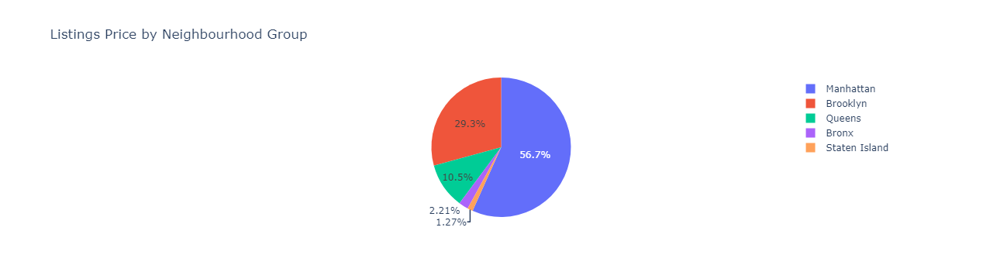

In [32]:
# creating a pie chart to visualize the distribution of listing prices by neighborhood group
fig = px.pie(df, values='price', 
             names='neighbourhood_group',  
             title='Listings Price by Neighbourhood Group')

fig.update_traces(hovertemplate='%{label}: <br>$%{value:,.0f}') 
fig.show()

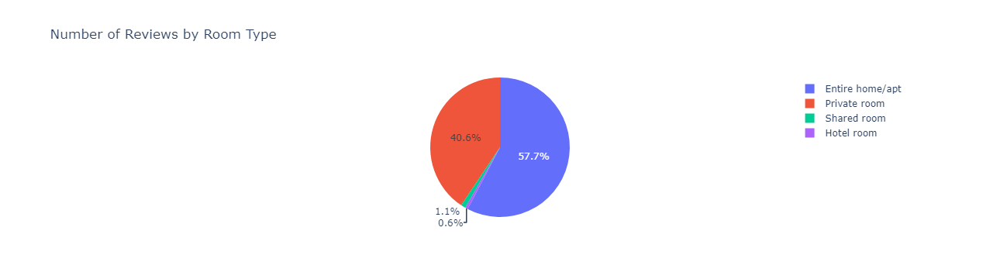

In [33]:
fig = px.pie(df, values='number_of_reviews', 
             names='room_type',
             title='Number of Reviews by Room Type')

fig.update_traces(hovertemplate='%{label}: <br>%{value:,}')
fig.show()


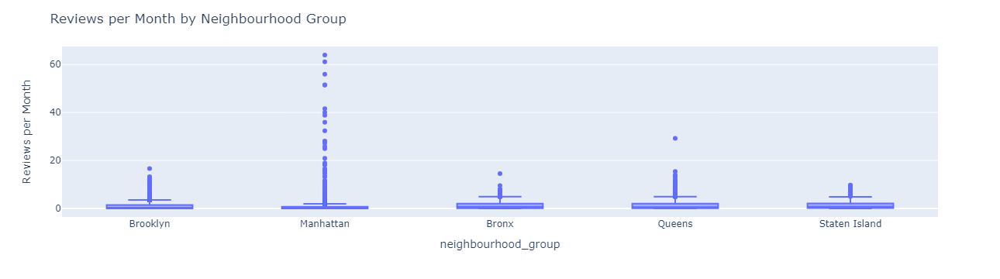

In [34]:
fig = px.box(df, x='neighbourhood_group', y='reviews_per_month')

fig.update_layout(title='Reviews per Month by Neighbourhood Group',
                  yaxis_title='Reviews per Month')

fig.show()

C:\Users\ayama\AppData\Local\Temp\ipykernel_21160\56756310.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



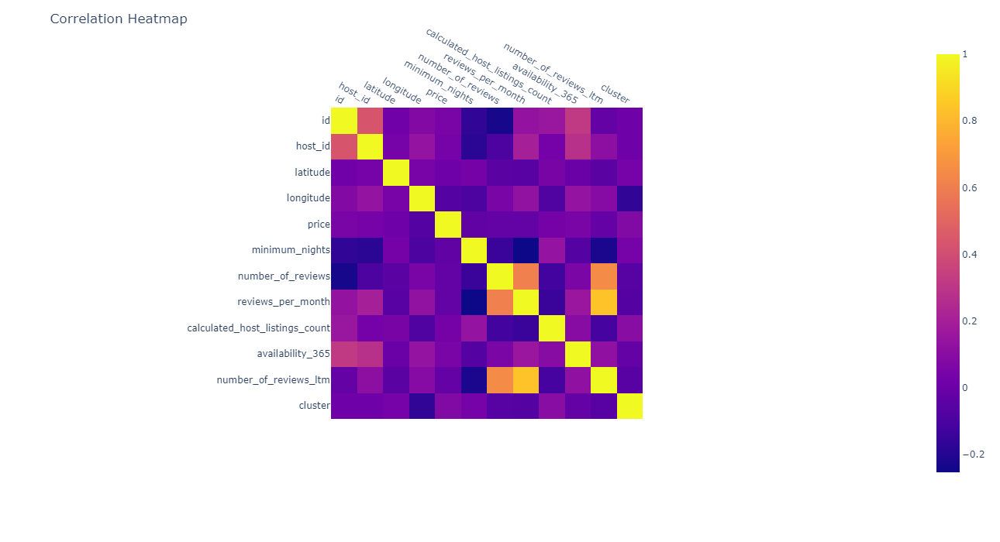

In [35]:
# Calculate correlation matrix 
corr = df.corr()

# Create heatmap
fig = px.imshow(corr)

# Customize heatmap appearance
fig.update_xaxes(side="top")
fig.update_layout(
    title='Correlation Heatmap',
    width=700, 
    height=700,
    yaxis_title=None, 
    xaxis_title=None
)

# Show heatmap
fig.show()

In [36]:
corr

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,cluster
id,1.000000,0.435560,0.019141,0.077585,0.050975,-0.166371,-0.230266,0.135013,0.155584,0.317320,-0.017596,0.013706
host_id,0.435560,1.000000,0.036104,0.139530,0.037491,-0.179213,-0.092885,0.198899,0.031727,0.279510,0.112161,0.012356
latitude,0.019141,0.036104,1.000000,0.044743,0.012211,0.033772,-0.048158,-0.053666,0.046813,-0.003491,-0.046252,0.038370
longitude,0.077585,0.139530,0.044743,1.000000,-0.071272,-0.092364,0.048419,0.128024,-0.081040,0.139217,0.087790,-0.164984
price,0.050975,0.037491,0.012211,-0.071272,1.000000,-0.029430,-0.023278,-0.022477,0.033155,0.049610,-0.017261,0.074637
minimum_nights,-0.166371,-0.179213,0.033772,-0.092364,-0.029430,1.000000,-0.143094,-0.253334,0.138776,-0.070387,-0.218511,0.034744
number_of_reviews,-0.230266,-0.092885,-0.048158,0.048419,-0.023278,-0.143094,1.000000,0.608667,-0.121843,0.054056,0.647668,-0.059288
reviews_per_month,0.135013,0.198899,-0.053666,0.128024,-0.022477,-0.253334,0.608667,1.000000,-0.143521,0.156428,0.836767,-0.069036
calculated_host_listings_count,0.155584,0.031727,0.046813,-0.081040,0.033155,0.138776,-0.121843,-0.143521,1.000000,0.095735,-0.111998,0.099673
availability_365,0.317320,0.279510,-0.003491,0.139217,0.049610,-0.070387,0.054056,0.156428,0.095735,1.000000,0.123934,-0.020611


**Null hypothesis**: There is no relationship between reviews per month and listing price.

**Alternative hypothesis**: Listings with more reviews per month have higher prices.

In [37]:
import statsmodels.formula.api as smf

# Fit regression model
model = smf.ols('price ~ reviews_per_month', data=df).fit()  

# Print model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     22.02
Date:                Thu, 17 Aug 2023   Prob (F-statistic):           2.71e-06
Time:                        07:00:16   Log-Likelihood:            -3.5404e+05
No. Observations:               43566   AIC:                         7.081e+05
Df Residuals:                   43564   BIC:                         7.081e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept           235.6451      4.50

- The p-value for reviews_per_month is 0.000, which is less than 0.05. This means we can reject the null hypothesis and conclude there is a significant relationship between reviews_per_month and price.
- The coefficient for reviews_per_month is -11.26. This suggests that for each additional review per month, price decreases by $11.26 on average.
- The relationship is negative, not positive as we originally hypothesized. More reviews per month are associated with lower prices.
- R-squared is very low, at 0.001. This means reviews_per_month only explains 0.1% of the variation in price.


**Question:** Is there a relationship between number of reviews and availability?

**Null hypothesis:** Number of reviews and availability are independent.

**Alternative:** Listings with higher availability have more reviews.

**Test:** Pearson correlation test between number_of_reviews and availability_365.

In [38]:
from scipy.stats import pearsonr
dfm = df[['number_of_reviews', 'availability_365']] 

# Calculate Pearson correlation
corr, p_value = pearsonr(dfm['number_of_reviews'], dfm['availability_365'])

print('Pearson Correlation:', corr)
print('P-value:', p_value)

Pearson Correlation: 0.05405627459260106
P-value: 1.4568594326841035e-29


**The output shows there is a small positive correlation of 0.05 between the number of reviews and availability.**
**And the p-value is very low (1.45e-29), which indicates the correlation is statistically significant.**
**So we can reject the null hypothesis and conclude there is a significant, albeit weak, positive correlation between number of reviews and availability.**

## let's play with colum name:

In [39]:
df.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm', 'cluster'],
      dtype='object')

In [98]:
df['city'] = df['name'].str.extract(r'in ([A-Za-z\s]+) ·') 
df['city']

0        Brooklyn
1        New York
2        New York
3        Brooklyn
4        New York
           ...   
43561    Brooklyn
43562    Brooklyn
43563    New York
43564    Brooklyn
43565    New York
Name: city, Length: 43566, dtype: object

In [99]:
df['review'] = df['name'].str.extract(r'★(\d\.\d{2})')
df['review'] 

0        4.52
1        4.68
2        4.93
3         NaN
4        4.77
         ... 
43561     NaN
43562     NaN
43563     NaN
43564     NaN
43565     NaN
Name: review, Length: 43566, dtype: object

In [100]:
# Extract bedrooms 
df['bedrooms'] = df['name'].str.extract(r'(\d+) bedrooms')
df['bedrooms'] = df['bedrooms'].str.extract(r'(\d+)', expand=False)

# Extract beds
df['beds'] = df['name'].str.extract(r'(\d+) beds')
df['beds'] = df['beds'].str.extract(r'(\d+)', expand=False)

In [92]:
df['bedrooms']

0        NaN
1        NaN
2        NaN
3          2
4          2
        ... 
43561      3
43562    NaN
43563    NaN
43564      3
43565    NaN
Name: bedrooms, Length: 43566, dtype: object

In [82]:
df['beds'] 

0        NaN
1        NaN
2        NaN
3          2
4          2
        ... 
43561      3
43562    NaN
43563    NaN
43564      5
43565    NaN
Name: beds, Length: 43566, dtype: object

In [101]:
df['baths'] = df['name'].str.extract(r'(\d+) baths')
df['baths'] = df['baths'].str.extract(r'(\d+)', expand=False)
df['baths']

0        NaN
1        NaN
2        NaN
3          5
4        NaN
        ... 
43561    NaN
43562    NaN
43563    NaN
43564      2
43565    NaN
Name: baths, Length: 43566, dtype: object

In [102]:
df.isna().sum()/(df.shape[0])*100

id                                 0.000000
name                               0.000000
host_id                            0.000000
host_name                          0.000000
neighbourhood_group                0.000000
neighbourhood                      0.000000
latitude                           0.000000
longitude                          0.000000
room_type                          0.000000
price                              0.000000
minimum_nights                     0.000000
number_of_reviews                  0.000000
reviews_per_month                  0.000000
calculated_host_listings_count     0.000000
availability_365                   0.000000
number_of_reviews_ltm              0.000000
cluster                            0.000000
location                           0.000000
bedrooms                          74.158748
beds                              63.510536
baths                             87.598127
city                               0.105587
review                          

In [103]:
df = df.fillna(0)

In [95]:
df.isna().sum()/(df.shape[0])*100

id                                0.0
name                              0.0
host_id                           0.0
host_name                         0.0
neighbourhood_group               0.0
neighbourhood                     0.0
latitude                          0.0
longitude                         0.0
room_type                         0.0
price                             0.0
minimum_nights                    0.0
number_of_reviews                 0.0
reviews_per_month                 0.0
calculated_host_listings_count    0.0
availability_365                  0.0
number_of_reviews_ltm             0.0
cluster                           0.0
location                          0.0
bedrooms                          0.0
beds                              0.0
baths                             0.0
city                              0.0
review                            0.0
dtype: float64

In [97]:
#df.sample(10)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,...,calculated_host_listings_count,availability_365,number_of_reviews_ltm,cluster,location,bedrooms,beds,baths,city,review
17517,3.648815e+07,Rental unit in The Bronx · ★4.67 · Studio · 1 ...,45364265.0,Yessica,Bronx,Kingsbridge,40.870190,-73.905220,Entire home/apt,94.0,...,2.0,9.0,10.0,1,The Bronx · ★4.67 · Studio · 1 bed,0,0,0,The Bronx,4.67
33052,6.905703e+17,Rental unit in New York · 1 bedroom · 1 bed · ...,22541573.0,Ken,Manhattan,Midtown,40.744560,-73.986890,Entire home/apt,403.0,...,132.0,328.0,0.0,4,New York · 1 bedroom · 1 bed,0,0,0,New York,0
26137,5.232095e+07,Rental unit in New York · 1 bedroom · 1 bed · ...,423452852.0,Larry,Manhattan,Theater District,40.762810,-73.984340,Entire home/apt,300.0,...,1.0,0.0,0.0,4,New York · 1 bedroom · 1 bed,0,0,0,New York,0
30187,6.059648e+17,Rental unit in Brooklyn · 1 bedroom · 1 bed · ...,347474872.0,Luke,Brooklyn,Bedford-Stuyvesant,40.686058,-73.931595,Private room,80.0,...,1.0,308.0,0.0,3,Brooklyn · 1 bedroom · 1 bed,0,0,0,Brooklyn,0
10825,2.002886e+07,Rental unit in Brooklyn · 1 bedroom · 1 bed · ...,39939372.0,Parish,Brooklyn,Bushwick,40.699570,-73.925400,Private room,41.0,...,1.0,0.0,0.0,3,Brooklyn · 1 bedroom · 1 bed,0,0,0,Brooklyn,0
6120,9.863045e+06,Loft in New York · ★4.65 · 1 bedroom · 1 bed ·...,16911403.0,Rabya,Manhattan,East Harlem,40.798645,-73.934341,Entire home/apt,194.0,...,1.0,125.0,3.0,1,New York · ★4.65 · 1 bedroom · 1 bed,0,0,0,New York,4.65
39912,8.353976e+17,Serviced apartment in New York · 1 bedroom · 1...,496944100.0,RoomPicks,Manhattan,Tribeca,40.716021,-74.010160,Entire home/apt,703.0,...,342.0,9.0,0.0,4,New York · 1 bedroom · 1 bed,0,0,0,New York,0
28819,5.508636e+17,Rental unit in Brooklyn · ★3.50 · 1 bedroom · ...,9917136.0,Rani,Brooklyn,Crown Heights,40.676390,-73.923210,Private room,41.0,...,5.0,31.0,4.0,3,Brooklyn · ★3.50 · 1 bedroom · 1 bed,0,0,0,Brooklyn,3.50
18097,3.806926e+07,Rental unit in New York · ★4.67 · 1 bedroom · ...,18934709.0,Katherine,Manhattan,Hell's Kitchen,40.757520,-73.993700,Private room,60.0,...,1.0,0.0,0.0,4,New York · ★4.67 · 1 bedroom · 1 bed,0,0,0,New York,4.67
33442,6.995448e+17,Rental unit in Queens · ★4.48 · 2 bedrooms · 2...,166286543.0,Mark,Queens,Sunnyside,40.739700,-73.915260,Entire home/apt,125.0,...,1.0,124.0,23.0,3,Queens · ★4.48 · 2 bedrooms · 2 beds,2,2,0,Queens,4.48


# extract some new Features

In [114]:
df['review'] = df['review'].astype("float")
df['baths'] = df['baths'].astype("int")
df['bedrooms'] = df['bedrooms'].astype("int")
df['beds'] = df['beds'].astype("int")

In [117]:
df = df[df["beds"]> 0]
df['price_per_bed'] = df['price'] / df['beds']
df.groupby('neighbourhood')['price_per_bed'].mean()

neighbourhood
Allerton           57.783454
Arden Heights      49.291667
Arrochar           47.533333
Arverne            75.339006
Astoria            68.165735
                     ...    
Windsor Terrace    70.408854
Woodhaven          43.496633
Woodlawn           61.047619
Woodrow            35.000000
Woodside           67.245392
Name: price_per_bed, Length: 219, dtype: float64

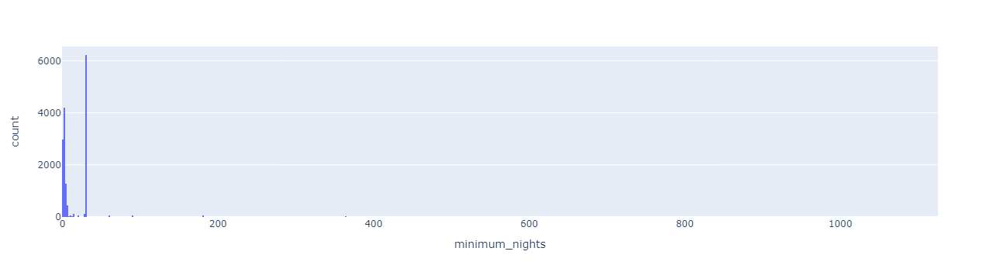

In [118]:
fig = px.histogram(df, x="minimum_nights")
fig.show()

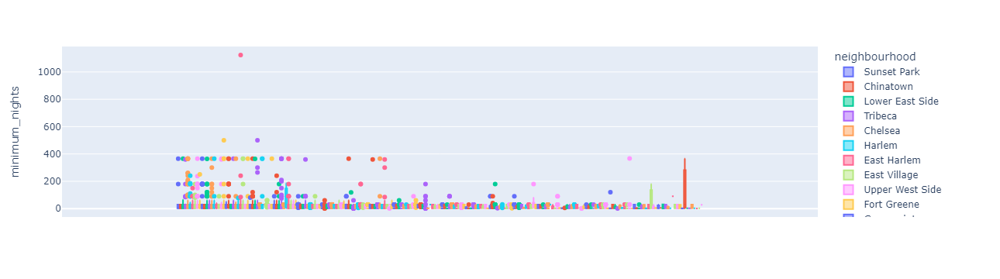

In [119]:
fig = px.box(df, y="minimum_nights", color="neighbourhood")
fig.show()

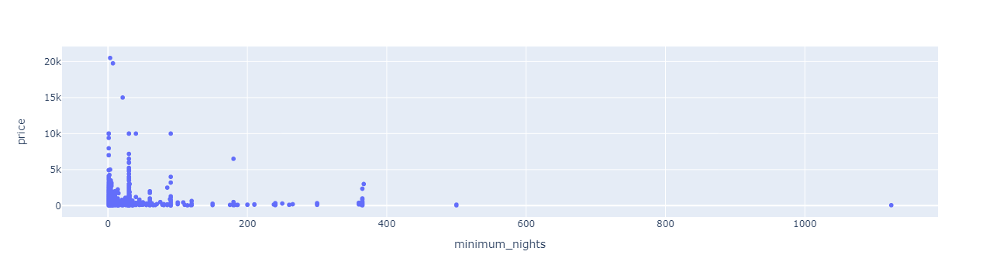

In [120]:
fig = px.scatter(df, x="minimum_nights", y="price")
fig.show()

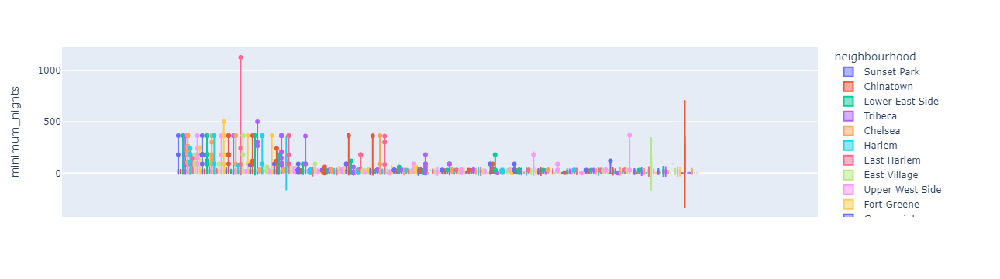

In [122]:
fig = px.violin(df, y="minimum_nights", color="neighbourhood", box=True)
fig.show()

In [123]:
df.drop("name",axis= 1)

,id,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,...,availability_365,number_of_reviews_ltm,cluster,location,bedrooms,beds,baths,city,review,price_per_bed
3,5.136000e+03,7378.0,Rebecca,Brooklyn,Sunset Park,40.662650,-73.994540,Entire home/apt,276.0,21.0,...,275.0,1.0,0,Brooklyn · ★5.0 · 2 bedrooms · 2 beds,2,2,5,Brooklyn,0.00,138.000000
4,5.970900e+04,186084.0,Ricardo & Ashlie,Manhattan,Chinatown,40.717800,-73.993200,Entire home/apt,325.0,7.0,...,38.0,23.0,4,New York · ★4.77 · 2 bedrooms · 2 beds,2,2,0,New York,4.77,162.500000
6,1.534100e+04,60049.0,Ted,Manhattan,Lower East Side,40.721359,-73.993668,Entire home/apt,315.0,30.0,...,160.0,4.0,4,New York · ★4.56 · 1 bedroom · 2 beds,0,2,0,New York,4.56,157.500000
9,6.016400e+04,289653.0,Harrison,Manhattan,Tribeca,40.720120,-74.003970,Entire home/apt,500.0,30.0,...,45.0,2.0,4,New York · ★4.39 · 3 bedrooms · 3 beds,3,3,0,New York,4.39,166.666667
11,1.539600e+04,60278.0,Petra,Manhattan,Chelsea,40.744930,-73.995210,Entire home/apt,400.0,90.0,...,107.0,0.0,4,New York · ★5.0 · 2 bedrooms · 2 beds,2,2,2,New York,0.00,200.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43556,9.050107e+17,40319757.0,Jd And Bailey,Manhattan,Hell's Kitchen,40.766500,-73.988536,Entire home/apt,1400.0,3.0,...,362.0,0.0,4,New York · ★New · 3 bedrooms · 3 beds,3,3,3,New York,0.00,466.666667
43558,9.050141e+17,40319757.0,Jd And Bailey,Manhattan,Civic Center,40.714259,-74.005310,Entire home/apt,997.0,1.0,...,365.0,0.0,4,New York · ★New · 2 bedrooms · 3 beds,2,3,2,New York,0.00,332.333333
43560,9.050193e+17,40319757.0,Jd And Bailey,Manhattan,Chinatown,40.718730,-74.001030,Entire home/apt,1300.0,1.0,...,364.0,0.0,4,New York · ★New · 4 bedrooms · 4 beds,4,4,0,New York,0.00,325.000000
43561,9.050311e+17,86368678.0,Jamel,Brooklyn,Canarsie,40.633458,-73.899472,Entire home/apt,208.0,3.0,...,358.0,0.0,3,Brooklyn · ★New · 3 bedrooms · 3 beds,3,3,0,Brooklyn,0.00,69.333333
